In [1]:
import qdmpy
import qdmpy.pl
import qdmpy.plot
import qdmpy.field
import qdmpy.source
import qdmpy.field.bnv

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

from collections import defaultdict as dd
import pickle
from tqdm.auto import tqdm

In [2]:
# '%matplotlib widget' allows interactive plots in jupyterlab
# use ''%matplotlib inline' to allow export to pdf
# %matplotlib widget

# [x] renormalise by baseline (largest value)
# [x] go above 1.0 for g
# [x] get fwhm rising again (find a minimum)
# [x] also show curves but on small region of flake
# [ ] also try a different dataset nearer centre of laser
# [x] test with polygon background subtraction

# GPU NOW SAMUEL
# [ ] test with lower binning (needs new polygons, zpn_region, FLAKE) -> maybe test with gpu {add tqdm globally, use for both}

### Load raw data

In [3]:
RUN_FITS = False
# FLAKE = (140, 100)
FLAKE = (44, 40)
NUM_G = 40

START_G, STOP_G = (0, 2.0)
REMOVE_G = [0.95, 1.05] # exclusive

options_dict = {
#     "base_dir": "/home/samsc/ResearchData/test_images/global_pl_test/",
    "base_dir": "C:/Widefield_processing_code/test_data/",
    "filepath": "ODMR - Pulsed_128",
    "custom_output_dir_suffix": "_{ROI}_bin_{total_bin}",
    
    "additional_bins": 8,
    
    "single_pixel_check": FLAKE,
    
    "exp_reference_type": "field",
    "plot_bnv_flip_with_bias_mag": False,
    "annotate_polygons": True,
    "standoff": 100e-9,
    "zero_point_normalisation_region": [[0, 60], [14, 72]],
#     "polygon_nodes_path": "/home/samsc/ResearchData/test_images/global_pl_test/polys8.json",
    "polygon_nodes_path": "C:/Widefield_processing_code/test_data/polys8.json",
    
    "fourier_pad_mode": "mean",
    "fourier_do_hanning_filter": False,
    
#     "polygon_nodes_path": "/home/samsc/ResearchData/test_images/global_pl_test/polys8.json",
    
    "system_name": "Cryo_Widefield",

    "ROI": "Rectangle", 
    "ROI_start": [37, 37],
    "ROI_end": [113, 167],
#     "ROI_start": [150, 150],
#     "ROI_end": [450,500],
    
    "fit_backend": "gpufit",
    "fit_backend_comparison": ["gpufit", "scipyfit"],
    "fit_pl_pixels": True, 
    "force_fit": True, 

    "use_ROI_avg_fit_res_for_all_pixels": True,    
    "scipyfit_sub_threads": 2, 

    "fit_functions":  {"linear": 1, "lorentzian": 2},

    "pos_guess": [2730, 3020],
    "pos_range": 25,

    "amp_guess": -0.015,
    "amp_bounds": [-0.300, -0.00003],
    
    "fwhm_bounds": [3, 20],
    
    "save_fig_type": "pdf",
    
    "freqs_to_use": [1, 0, 0, 0, 0, 0, 0, 1],
    "diamond_ori": "<100>_<100>", # HPHT
    
    "auto_read_bias": True,
    
    "colormap_range_dicts": {
        "bnv_images": {
            "type": "mean_plus_minus",
            "values": 2
        },
        "bfield_images": {
            "type": "percentile",
            "values": [2, 98]
        },
        "magnetization_images": {
            "type": "strict_range",
            "values": [-100, 100]
        },
        "residual_images": {
            "type": "strict_range",
            "values": [0, 0.05]
        },
        "sigma_images": {
            "type": "percentile",
            "values": [2, 98]
        },
        "param_images": {
            "type": "percentile",
            "values": [2, 98]
        },
        "dshift_images": {
            "type": "percentile",
            "values": [2, 98]
        },
    },
    
    "recon_methods": ["from_bnv"]
}

In [4]:
options, ref_options = qdmpy.initialize(
    options_dict=options_dict,
    ref_options_dir=None,
    set_mpl_rcparams=True
)

C:\Users\Zyla\Miniconda3\envs\QDMPy\lib\site-packages\qdmpy\interface.py:226: UserWarning: Continuing without reference. (No reference chosen or exp_referece_type was 'None')
  warnings.warn(


C:\Users\Zyla\Miniconda3\envs\QDMPy\lib\site-packages\qdmpy\pl\io.py:413: UserWarning: ROI Rectangle too big in y, cropping to image.
  warnings.warn(f"{name} Rectangle too big in y, cropping to image.")


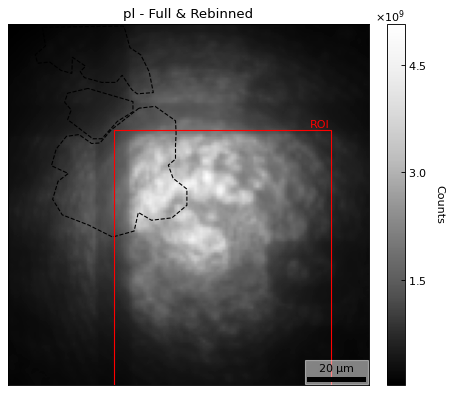

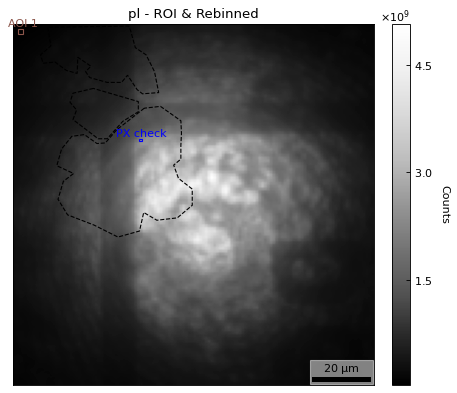

In [5]:
image, prelim_sweep_list = qdmpy.pl.load_image_and_sweep(options)
PL_image, PL_image_ROI, sig, ref, full_sig_norm, single_pixel_pl, sweep_list, ROI = qdmpy.pl.reshape_dataset(
        options, image, prelim_sweep_list
    )

ROI_PL_fig = qdmpy.plot.roi_pl_image(options, PL_image)
AOI_PL_fig = qdmpy.plot.aoi_pl_image(options, PL_image)
qdmpy.pl.save_pl_data(options, PL_image, PL_image_ROI)

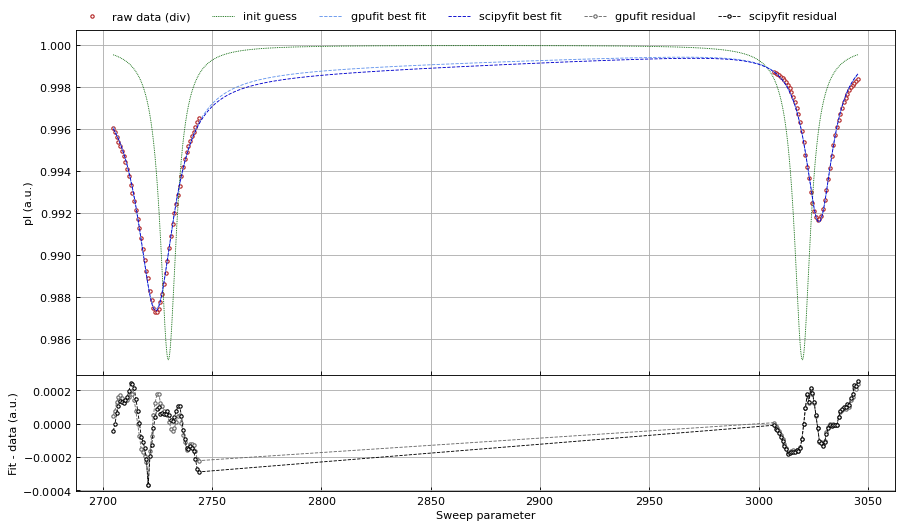

In [6]:
fit_model = qdmpy.pl.define_fit_model(options)
backend_ROI_results_lst = qdmpy.pl.fit_roi_avg_pl(options, full_sig_norm, sweep_list, fit_model)
ROI_fit_fig = qdmpy.plot.roi_avg_fits(options, backend_ROI_results_lst)
wanted_roi_result = next(
    filter(
        lambda result: result.fit_backend == options["fit_backend"], backend_ROI_results_lst
    )
) # ROI fit result for chosen fit backend
roi_raw_vec = wanted_roi_result.pl_roi

# subtract g * roi_fit from every pixel in sig_norm.
# wanted_roi_result.best_params[0], wanted_roi_result.best_params[1] = 0, 0
roi_fit_vec = wanted_roi_result.fit_model(wanted_roi_result.best_params, wanted_roi_result.sweep_list)

In [7]:
def renorm(ar):
    argmax = np.expand_dims(np.argmax(np.abs(ar), axis=0), axis=0)
    return ar / np.take_along_axis(ar, argmax, axis=0)

def get_key_results(sig_norm, options, sweep_list, fit_model):
    roi_results = qdmpy.pl.fit_roi_avg_pl(options, sig_norm, sweep_list, fit_model)
    new_roi_avg = next(
            filter(
                lambda result: result.fit_backend == options["fit_backend"], roi_results
        )
    )
    avg_spectra = new_roi_avg.pl_roi
    fit_results, sigmas = qdmpy.pl.get_pl_fit_result(options, sig_norm, sweep_list, fit_model, new_roi_avg)
    
    bnvs, _ = qdmpy.field.bnv.get_bnvs_and_dshifts(fit_results, options["bias_field_spherical_deg_gauss"])
    
    fwhm = [fit_results["fwhm_0"], fit_results["fwhm_1"]]
    bnv = bnvs[0]
    resid = fit_results["residual_0"]
    
    return avg_spectra, fwhm, bnv, resid

class Results:
    
    def __init__(self, g_vec):
        self.g_vec = g_vec
        
        self.spectra_lst = []
        self.fwhm_lst = []
        self.bnv_lst = []
        self.resid_lst = []
        self.bnv_sbg_lst = []
        self.mz_lst = []

        self.fwhm_stats = dd(list)
        self.bnv_stats = dd(list)
        self.bnv_sbg_stats = dd(list)
        self.resid_stats = dd(list)
        self.mz_stats = dd(list)
    
    def append_key_results(self, key_res):
        avg_spectra, fwhm, bnv, resid = key_res
        self.spectra_lst.append(avg_spectra)
        self.fwhm_lst.append(fwhm)
        self.bnv_lst.append(bnv)
        self.resid_lst.append(resid)
        
    def append_other_results(self, other_res):
        bnv_sbg, mz = other_res
        self.bnv_sbg_lst.append(bnv_sbg)
        self.mz_lsts.append(mz)
        
    def get_other_results(self, options, bnv_bground_method, **bnv_bground_opts):
        for g_idx, _ in enumerate(self.g_vec):
            bnv = self.bnv_lst[g_idx]
            bnv_sub_bground =  qdmpy.field.bnv.sub_bground_bnvs(options, [bnv], bnv_bground_method, **bnv_bground_opts)
            self.bnv_sbg_lst.append(bnv_sub_bground[0])
            source_params = qdmpy.source.odmr_source_retrieval(options, bnv_sub_bground, None)
            self.mz_lst.append(source_params["Mz_from_bnv"])
        
    def compile_stats(self):
        fwhm_stats = dd(list)
        bnv_stats = dd(list)
        bnv_sbg_stats = dd(list)
        resid_stats = dd(list)
        mz_stats = dd(list)
        for g_idx, g in enumerate(self.g_vec):
            self.fwhm_stats["means_0"].append(np.mean(self.fwhm_lst[g_idx][0]))
            self.fwhm_stats["means_1"].append(np.mean(self.fwhm_lst[g_idx][1]))

            self.fwhm_stats["flake_means_0"].append(self.fwhm_lst[g_idx][0][FLAKE[1], FLAKE[0]])
            self.fwhm_stats["flake_means_1"].append(self.fwhm_lst[g_idx][1][FLAKE[1], FLAKE[0]])

            self.fwhm_stats["std_0"].append(np.std(self.fwhm_lst[g_idx][0]))
            self.fwhm_stats["std_1"].append(np.std(self.fwhm_lst[g_idx][1]))

            self.bnv_stats["mean"].append(np.mean(self.bnv_lst[g_idx]))
            self.bnv_stats["flake_mean"].append(self.bnv_lst[g_idx][FLAKE[1], FLAKE[0]])
            self.bnv_stats["std"].append(np.std(self.bnv_lst[g_idx]))

            self.bnv_sbg_stats["mean"].append(np.mean(self.bnv_sbg_lst[g_idx]))
            self.bnv_sbg_stats["flake_mean"].append(self.bnv_sbg_lst[g_idx][FLAKE[1], FLAKE[0]])
            self.bnv_sbg_stats["std"].append(np.std(self.bnv_sbg_lst[g_idx]))

            self.resid_stats["mean"].append(np.mean(self.resid_lst[g_idx]))
            self.resid_stats["flake_mean"].append(self.resid_lst[g_idx][FLAKE[1], FLAKE[0]])
            self.resid_stats["std"].append(np.std(self.resid_lst[g_idx]))

            self.mz_stats["mean"].append(np.mean(self.mz_lst[g_idx]))
            self.mz_stats["flake_mean"].append(self.mz_lst[g_idx][FLAKE[1], FLAKE[0]])
            self.mz_stats["std"].append(np.std(self.mz_lst[g_idx]))

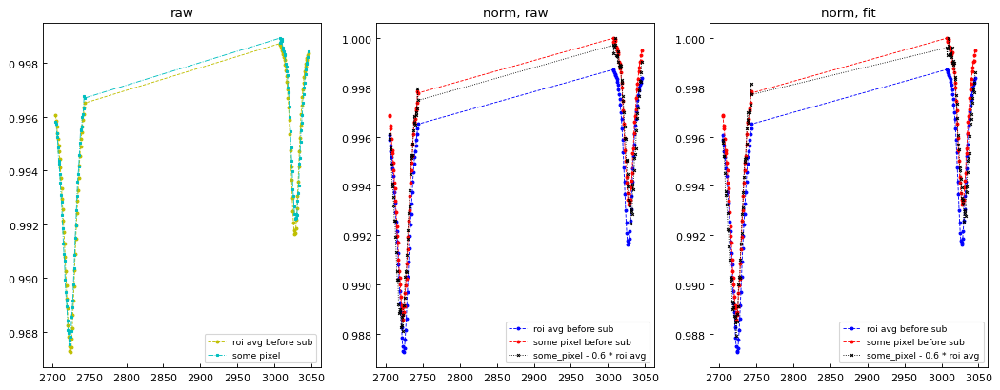

In [8]:
test_g = 0.6
slicer = np.s_[:, 50, 50]

# test subtraction
full_sig_norm.shape
full_sig_norm[:, 0, 0]
a = np.linspace(1, 99, 99)
sub_avg_raw = full_sig_norm - test_g * roi_raw_vec[:, None, None]
sub_avg_fit = full_sig_norm - test_g * roi_fit_vec[:, None, None]

sub_avg_raw_norm = renorm(sub_avg_raw)
sub_avg_fit_norm = renorm(sub_avg_fit)
without_sub_norm = renorm(full_sig_norm)

tf, tas = plt.subplots(ncols=3, figsize=(16, 6))
tas[0].set_title("raw")
tas[0].plot(sweep_list, roi_raw_vec, "o--y", ms=2.5, label="roi avg before sub")
# tas[0].plot(sweep_list, np.mean(np.mean(sub_avg_norm,axis=2), axis=1), "s-.m", ms=2.5, label="roi avg with sub")
tas[0].plot(sweep_list, full_sig_norm[slicer], "s-.c", ms=2.5, label="some pixel")
tas[0].legend(loc="lower right")
# tas[0].plot(sweep_list, full_sig_norm[:, 50, 50] - 0.8 * roi_avg_vec, "x-k", ms=2.5, label=f"some_pixel - {test_g} * roi avg")

tas[1].set_title("norm, raw")
tas[1].plot(sweep_list, roi_raw_vec, "o--b", ms=2.5, label="roi avg before sub")
tas[1].plot(sweep_list, without_sub_norm[slicer], "o--r", ms=2.5, label="some pixel before sub")
tas[1].plot(sweep_list, sub_avg_raw_norm[slicer], "x:k", ms=2.5, label=f"some_pixel - {test_g} * roi avg")
tas[1].legend(loc="lower right")

tas[2].set_title("norm, fit")
tas[2].plot(sweep_list, roi_raw_vec, "o--b", ms=2.5, label="roi avg before sub")
tas[2].plot(sweep_list, without_sub_norm[slicer], "o--r", ms=2.5, label="some pixel before sub")
tas[2].plot(sweep_list, sub_avg_fit_norm[slicer], "x:k", ms=2.5, label=f"some_pixel - {test_g} * roi avg")
# tas[2].plot(sweep_list, sub_avg_fit[slicer], "x:m", ms=2.5, label=f"no-norm, some_pixel - {test_g} * roi avg")
tas[2].legend(loc="lower right")

None

In [9]:
g_vec = np.linspace(start=START_G, stop=STOP_G, num=NUM_G)
if REMOVE_G is not None:
    keep_these = np.logical_or(REMOVE_G[1] <= g_vec, g_vec <= REMOVE_G[0])
    g_vec = g_vec[keep_these]
g_vec = g_vec.tolist()
if RUN_FITS:
    raw_result = Results(g_vec)
    fit_result = Results(g_vec)
    
    for g in tqdm(g_vec, desc="Global fit progress"):        
        sub_avg_raw = full_sig_norm - g * roi_raw_vec[:, None, None]
        sub_avg_fit = full_sig_norm - g * roi_fit_vec[:, None, None]

        raw_result.append_key_results(get_key_results(renorm(sub_avg_raw), options, sweep_list, fit_model))
        fit_result.append_key_results(get_key_results(renorm(sub_avg_fit), options, sweep_list, fit_model))
#         fit_result.append_key_results(get_key_results(sub_avg_fit, options, sweep_list, fit_model))
        
    with open(options["base_dir"] + f"results_128_{options['additional_bins']}.pickle", "wb") as f:
        pickle.dump([raw_result, fit_result], f, pickle.HIGHEST_PROTOCOL)
else:
    with open(options["base_dir"] +  f"results_128_{options['additional_bins']}.pickle", 'rb') as f:
        raw_result, fit_result = pickle.load(f)

In [10]:
raw_result.get_other_results(options, "interpolate", interp_method="linear", sigma=3)
fit_result.get_other_results(options, "interpolate", interp_method="linear", sigma=3)

In [11]:
fwhm_c_map = "viridis"
fwhm_c_range_dict = {"type": "strict_range", "values": [0,25]}

bnv_c_map = "bwr"
bnv_c_range_dict = {"type": "mean_plus_minus", "values": 2}

sigma_c_map = "magma"
sigma_c_range_dict = {"type": "strict_range", "values": [0, 0.05]}

delta_fwhm_c_map = "jet"
delta_fwhm_c_range_dict = {"type": "strict_range", "values": [-15, 15]}

mz_c_map = "PuOr"
mz_c_range_dict = {"type": "strict_range","values": [-100, 100]}
    
nrows = len(raw_result.g_vec)
ncols = (options["fit_functions"]["lorentzian"] + 2) * 2
fsize = matplotlib.rcParams["figure.figsize"].copy()
fsize[0] *= ncols * 0.85
fsize[1] *= nrows
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, constrained_layout=True, figsize=fsize)

for g_idx, g_value in enumerate(raw_result.g_vec):
    for (i, result), name in zip(enumerate((raw_result, fit_result)), ("raw", "fit")):
        axs[g_idx, 0 + 4*i].plot(
            sweep_list,
            result.spectra_lst[g_idx],
            label=f"new spectrum",
            ls=" ",
            marker="o",
            mfc="w",
            mec="firebrick",
        )
        axs[g_idx, 0 + 4*i].set_title(f"g = {g_value}, avg. spectrum, {name}")

        for fwhm_idx in range(2):
            fwhm_image = result.fwhm_lst[g_idx][fwhm_idx] 
            fwhm_c_range = qdmpy.plot.get_colormap_range(fwhm_c_range_dict, fwhm_image)
            qdmpy.plot.plot_image_on_ax(fig, axs[g_idx, fwhm_idx + 1 + 4*i], options, fwhm_image, f"g = {g_value}, fwhm_{fwhm_idx}, {name}", fwhm_c_map, fwhm_c_range, "FWHM (MHz)")

        # plot delta fwhm from g = 0
        delta_fwhm_image = result.fwhm_lst[g_idx][0] + result.fwhm_lst[g_idx][1] - result.fwhm_lst[0][0] - result.fwhm_lst[0][1]
        delta_fwhm_range = qdmpy.plot.get_colormap_range(delta_fwhm_c_range_dict, delta_fwhm_image)
        qdmpy.plot.plot_image_on_ax(fig, axs[g_idx, 3 + 4*i], options, delta_fwhm_image, f"g = {g_value},  " + r"$\Delta fwhm$, " + name, delta_fwhm_c_map, delta_fwhm_range, "(2*) FWHM (MHz)")    

fig.savefig(options["base_dir"] + "fits_128.pdf")
    
nrows = len(g_vec)
ncols = 4 * 2
fsize = matplotlib.rcParams["figure.figsize"].copy()
fsize[0] *= ncols * 0.85
fsize[1] *= nrows
figure, axes = plt.subplots(nrows=nrows, ncols=ncols, constrained_layout=True, figsize=fsize)
for g_idx, g_value in enumerate(raw_result.g_vec):
    for (i, result), name in zip(enumerate((raw_result, fit_result)), ("raw", "fit")):

        # plot (summed) residual
        residual_c_range = qdmpy.plot.get_colormap_range(sigma_c_range_dict, result.resid_lst[g_idx])
        qdmpy.plot.plot_image_on_ax(figure, axes[g_idx, 0 + 4*i], options, result.resid_lst[g_idx], f"g = {g_value},  residual, {name}", sigma_c_map, residual_c_range, "Residual summed (a.u.)")

        # plot bnv
        bnv_c_range = qdmpy.plot.get_colormap_range(bnv_c_range_dict, result.bnv_lst[g_idx])
        qdmpy.plot.plot_image_on_ax(figure, axes[g_idx, 1 + 4*i], options,result. bnv_lst[g_idx], f"g = {g_value}, bnv, {name}", bnv_c_map, bnv_c_range, "B_NV (G)")
        if not g_idx:
            np.savetxt(options["base_dir"] + "bnv.txt", result.bnv_lst[g_idx])

        # plot bnv_sub_bground
        bnv_c_range2 = qdmpy.plot.get_colormap_range(bnv_c_range_dict, result.bnv_sbg_lst[g_idx])
        qdmpy.plot.plot_image_on_ax(figure, axes[g_idx, 2 + 4*i], options, result.bnv_sbg_lst[g_idx], f"g = {g_value}, bnv_sub_bground, {name}", bnv_c_map, bnv_c_range2, "B_NV (G)")

        # plot magnetization
        mz_c_range = qdmpy.plot.get_colormap_range(mz_c_range_dict, result.mz_lst[g_idx])
        qdmpy.plot.plot_image_on_ax(figure, axes[g_idx, 3 + 4*i], options, result.mz_lst[g_idx], f"g = {g_value},  mz, {name}", mz_c_map, mz_c_range, "Mz (mu_b/nm^2)")

figure.savefig(options["base_dir"] + "fields_128.pdf")

In [12]:
raw_result.compile_stats()
fit_result.compile_stats()

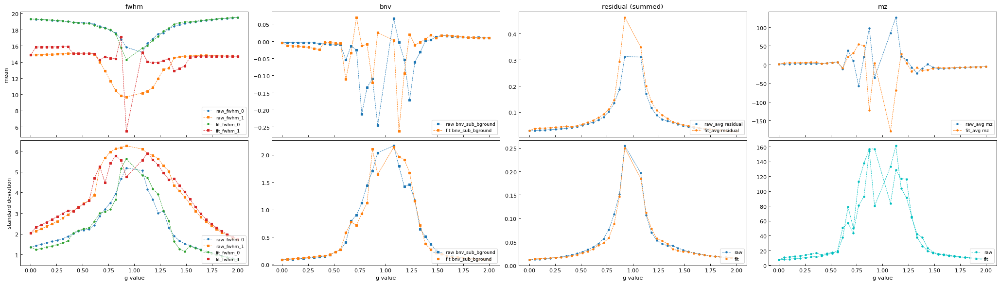

In [13]:
fs = matplotlib.rcParams["figure.figsize"].copy()
fs[0] *= 4
fs[1] *= 1.5
cfig, caxs = plt.subplots(nrows=2, ncols=4, constrained_layout=True, sharex=True, figsize=fs)

matplotlib.rcParams['axes.prop_cycle'] = matplotlib.cycler(color=[plt.cm.tab20(i) for i in range(20)])

plot_avgs = True
plot_flakes = False
plot_bnv = False
plot_bnv_sbg = True

for result, name in zip((raw_result, fit_result), ("raw", "fit")):
    caxs[0, 0].set_title("fwhm")
    if plot_avgs:
        caxs[0, 0].plot(g_vec, result.fwhm_stats["means_0"], "o--", label=f"{name}_fwhm_0")
        caxs[0, 0].plot(g_vec, result.fwhm_stats["means_1"], "s--", label=f"{name}_fwhm_1")
        caxs[1, 0].plot(g_vec, result.fwhm_stats["std_0"], "o--", label=f"{name}_fwhm_0")
        caxs[1, 0].plot(g_vec, result.fwhm_stats["std_1"], "s--", label=f"{name}_fwhm_1")
    if plot_flakes:
        caxs[0, 0].plot(g_vec, result.fwhm_stats["flake_means_0"], "o-.", label=f"{name}_flake fwhm_0")
        caxs[0, 0].plot(g_vec, result.fwhm_stats["flake_means_1"], "s-.", label=f"{name}_flake fwhm_1")
    caxs[0, 0].set_ylabel("mean")
    caxs[1, 0].set_xlabel("g value")
    caxs[1, 0].set_ylabel("standard deviation")
    caxs[0, 0].legend(loc="lower right")
    caxs[1, 0].legend(loc="lower right")

    caxs[0, 1].set_title("bnv")
    if plot_flakes:
        if plot_bnv:
            caxs[0, 1].plot(g_vec, result.bnv_stats["flake_mean"], "o-.", label=f"{name}_flake bnv")
        if plot_bnv_sbg:
            caxs[0, 1].plot(g_vec, result.bnv_sbg_stats["flake_mean"], "s-.", label=f"{name}_flake bnv_sub_bground")
    if plot_avgs:
        if plot_bnv:
            caxs[0, 1].plot(g_vec, result.bnv_stats["mean"], "o--", label=f"{name} bnv")
            caxs[1, 1].plot(g_vec, result.bnv_stats["std"], "o--", label=f"{name} bnv")
        if plot_bnv_sbg:
            caxs[0, 1].plot(g_vec, result.bnv_sbg_stats["mean"], "s--", label=f"{name} bnv_sub_bground")
            caxs[1, 1].plot(g_vec, result.bnv_sbg_stats["std"], "s--", label=f"{name} bnv_sub_bground")
        
    caxs[1, 1].set_xlabel("g value")
    caxs[0, 1].legend(loc="lower right")
    caxs[1, 1].legend(loc="lower right")

    caxs[0, 2].set_title("residual (summed)")
    if plot_avgs:
        caxs[0, 2].plot(g_vec, result.resid_stats["mean"], "o--", label=f"{name}_avg residual")
        caxs[1, 2].plot(g_vec, result.resid_stats["std"], "o--", label=name)
    if plot_flakes:
        caxs[0, 2].plot(g_vec, result.resid_stats["flake_mean"], "o--", label=f"{name}_flake residual")
    
    caxs[1, 2].set_xlabel("g value")
    caxs[0, 2].legend(loc="lower right")
    caxs[1, 2].legend(loc="lower right")

    caxs[0, 3].set_title("mz")
    if plot_flakes:
        caxs[0, 3].plot(g_vec, result.mz_stats["flake_mean"], "o--", label=f"{name}_flake mz")
    if plot_avgs:
        caxs[0, 3].plot(g_vec, result.mz_stats["mean"], "o--", label=f"{name}_avg mz")
        caxs[1, 3].plot(g_vec, result.mz_stats["std"], "o--c", label=name)
    caxs[1, 3].set_xlabel("g value")
    caxs[0, 3].legend(loc="lower right")
    caxs[1, 3].legend(loc="lower right")
    
cfig.savefig(options["base_dir"] + "curves_128.pdf")
None

### Save and (optionally) view options dict

In [14]:
qdmpy.save_options(options)
# import qdmpy.shared.json2dict; print(qdmpy.shared.json2dict.dict_to_json_str(options))

## 